# Elecciones de Puebla 2019
#### Un analisis y visualizacion geografica de las elecciones de Junio 2019 en Puebla, Mexico.

<details>
    <summary><strong>Meta</strong></summary>
    La meta de este notebook es crear un mapa interactivo utilizando los datos de las elecciones de puebla en junio 2019.
    <ul>
        <li> Metas mensurables </li>
        <li> Identificar variables de interes en el conjunto de datos que @YaNiPaper limpió.</li>
        <li> Crear un mapa como el que @palewire publicó en twitter: https://twitter.com/palewire/status/1137815979780476928</li>
    </ul>
</details>

<details>
    <summary><strong>Contexto</strong></summary>
    @YaNiPaper limpió los datos y creo mapas (que se encuentran en el directorio: <code style="background-color:#eee">reportes/figuras/</code>.
    <li> Lo que queremos hacer es recrear el mapa de @palewire con datos de puebla.</li>
</details>

In [1]:
import pandas as pd
from zipfile import ZipFile
from pathlib import Path
from herramientas import arbol
import arrow
import altair as alt
import geopandas as gpd
import gpdvega

hoy = arrow.now('local').format(fmt = 'DD-MMM-YY', locale = 'es')

hoy

'10-jun-19'

In [2]:
%matplotlib inline

In [3]:
DATOS_BRUTOS = Path("../datos/brutos/")
DATOS_INTERINOS = Path("../datos/interinos/")
DATOS_PROCESADOS = Path("../datos/procesados/")
DATOS_EXTERNOS = Path("../datos/externos/")

In [4]:
arbol(DATOS_BRUTOS)

+ ..\datos\brutos
    + 21_CATALOGO_SECCIONES.xlsx
    + 21_CATALOGO_SECCIONESa.csv
    + municipios
        + MUNICIPIOS.dbf
        + MUNICIPIOS.prj
        + MUNICIPIOS.shp
        + MUNICIPIOS.shx
    + PUE_GUB_ext_2019a.csv
    + PUE_GUB_ext_2019b.xlsx


In [5]:
arbol(DATOS_EXTERNOS)

+ ..\datos\externos
    + computos_elecciones_puebla_por_seccion_2019.csv
    + eleccion_puebla_computos_2019.xlsx
    + elecciones_pueba_2019.csv
    + elecciones_pueba_por_municipio_2019.csv
    + elecciones_puebla_2019.csv
    + elecciones_puebla_computos_2019.csv
    + elecciones_puebla_por_municipio_2019.csv
    + elecciones_puebla_por_municipio_computo_2019.csv
    + elecciones_puebla_por_municipio_computo_2019_coordenadas.csv
    + elecciones_puebla_por_seccion_2019.csv
    + mapas_puebla
        + DISTRITO.dbf
        + DISTRITO.prj
        + DISTRITO.qpj
        + DISTRITO.shp
        + DISTRITO.shx
        + ENTIDAD.dbf
        + ENTIDAD.prj
        + ENTIDAD.qpj
        + ENTIDAD.shp
        + ENTIDAD.shx
        + MUNICIPIO.dbf
        + MUNICIPIO.prj
        + MUNICIPIO.qpj
        + MUNICIPIO.shp
        + MUNICIPIO.shx
        + SECCION.dbf
        + SECCION.prj
        + SECCION.qpj
        + SECCION.shp
        + SECCION.shx
    + municipios_puebla.xls


In [6]:
datos_por_municipio = pd.read_csv(DATOS_EXTERNOS / 'elecciones_puebla_por_municipio_computo_2019.csv')

datos_por_municipio.head()

,ID_MUNICIPIO,MUNICIPIO,ALBERTO_JIMENEZ,ENRIQUE_CARDENAS,MIGUEL_BARBOSA,NO_REGISTRADOS,NULOS,TOTAL_VOTOS,LISTA_NOMINAL,aj_porc,ec_porc,mb_porc,no_reg_porc,nulos_porc,parti_porc,abst_porc,GANADOR,PORC_GANADOR,CVE_GANADOR
0,1,ACAJETE,3724,2917,3675,6,303,10625,45097,35.05,27.45,34.59,0.06,2.85,23.56,76.44,ALBERTO_JIMENEZ,35.05,1
1,2,ACATENO,503,226,2335,4,87,3155,6978,15.94,7.16,74.01,0.13,2.76,45.21,54.79,MIGUEL_BARBOSA,74.01,3
2,3,ACATLAN,1777,1246,4455,6,215,7699,28427,23.08,16.18,57.86,0.08,2.79,27.08,72.92,MIGUEL_BARBOSA,57.86,3
3,4,ACATZINGO,2558,2778,3106,20,229,8691,37475,29.43,31.96,35.74,0.23,2.63,23.19,76.81,MIGUEL_BARBOSA,35.74,3
4,5,ACTEOPAN,283,98,729,0,54,1164,2333,24.31,8.42,62.63,0.00,4.64,49.89,50.11,MIGUEL_BARBOSA,62.63,3


In [7]:
puebla = gpd.read_file(DATOS_EXTERNOS / 'mapas_puebla' / 'MUNICIPIO.shp')

In [8]:
puebla.head()

,gid,id,entidad,municipio,nombre,control,geometry1_,geometry
0,1,66.0,21,1,ACAJETE,67.0,None,"POLYGON ((607552.153001085 2102577.75040513, 6..."
1,2,169.0,21,2,ACATENO,175.0,None,"POLYGON ((687604.536279954 2218598.67690477, 6..."
2,3,25.0,21,3,ACATLAN,25.0,None,"(POLYGON ((606149.074408127 2018062.39644271, ..."
3,4,102.0,21,4,ACATZINGO,103.0,None,"POLYGON ((625483.645090082 2096032.04553089, 6..."
4,5,127.0,21,5,ACTEOPAN,131.0,None,"POLYGON ((531458.765347764 2080441.15751206, 5..."


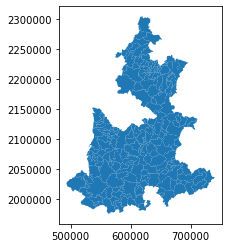

In [9]:
puebla.plot();

In [10]:
puebla.shape

(217, 8)

In [11]:
puebla_con_datos = puebla.merge(datos_por_municipio, left_on = ['municipio', 'nombre'], right_on = ['ID_MUNICIPIO', 'MUNICIPIO'])

In [12]:
puebla_con_datos.head(2).T

,0,1
gid,1,2
id,66,169
entidad,21,21
municipio,1,2
nombre,ACAJETE,ACATENO
control,67,175
geometry1_,None,None
geometry,"POLYGON ((607552.153001085 2102577.75040513, 6...","POLYGON ((687604.536279954 2218598.67690477, 6..."
ID_MUNICIPIO,1,2
MUNICIPIO,ACAJETE,ACATENO


In [13]:
puebla_con_datos = puebla_con_datos.rename(columns = {
    "ENRIQUE_CARDENAS": "Enrique Cárdenas Sánchez",
    "ALBERTO_JIMENEZ": "Alberto Jiménez Merino",
    "MIGUEL_BARBOSA": "Miguel Barbosa Huerta",
    "NO_REGISTRADOS": "No registrados",
    "NULOS": "Votos nulos",
    "TOTAL_VOTOS": "Total de votos",
    "GANADOR": "Ganador",
    "PORC_GANADOR": "% del ganador"
})

In [14]:
puebla_con_datos['Ganador'] = puebla_con_datos['Ganador'].str.replace("_", ' ').str.title()

In [15]:
# centroides
puebla_con_datos['centroide_x'] = puebla_con_datos['geometry'].centroid.x
puebla_con_datos['centroide_y'] = puebla_con_datos['geometry'].centroid.y

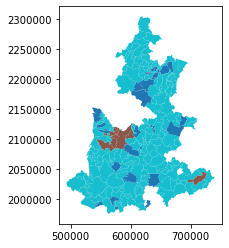

In [16]:
puebla_con_datos.plot(column = 'Ganador');

## palewire's

In [17]:
base = alt.Chart(puebla_con_datos).mark_geoshape(
    stroke='black',
    strokeWidth=0.1
).encode().properties(
    width=600,
    height=800
)

In [18]:
geoshape = alt.Chart(puebla_con_datos).mark_geoshape(
    fill='lightgray',
    stroke='black'
)

In [19]:
outcome = geoshape.encode(
    color=alt.Color(
        "Ganador:N",
        title="Ganador"
    ),
    tooltip = ['Enrique Cárdenas Sánchez:Q', 'Alberto Jiménez Merino:Q', 'Miguel Barbosa Huerta:Q', 'Votos nulos:Q', 'Total de votos:Q', 'Ganador:N', '% del ganador:Q']
)

C:\Users\sanchez\AppData\Local\Continuum\anaconda3\envs\puebla_data\lib\site-packages\gpdvega\geodata.py:27: UserWarning: Column name 'id' is reserved name for GeoDataFrame for index values. Data of column 'id' will not be accessible from the chart description.
  "index values. Data of column 'id' will not be accessible " +


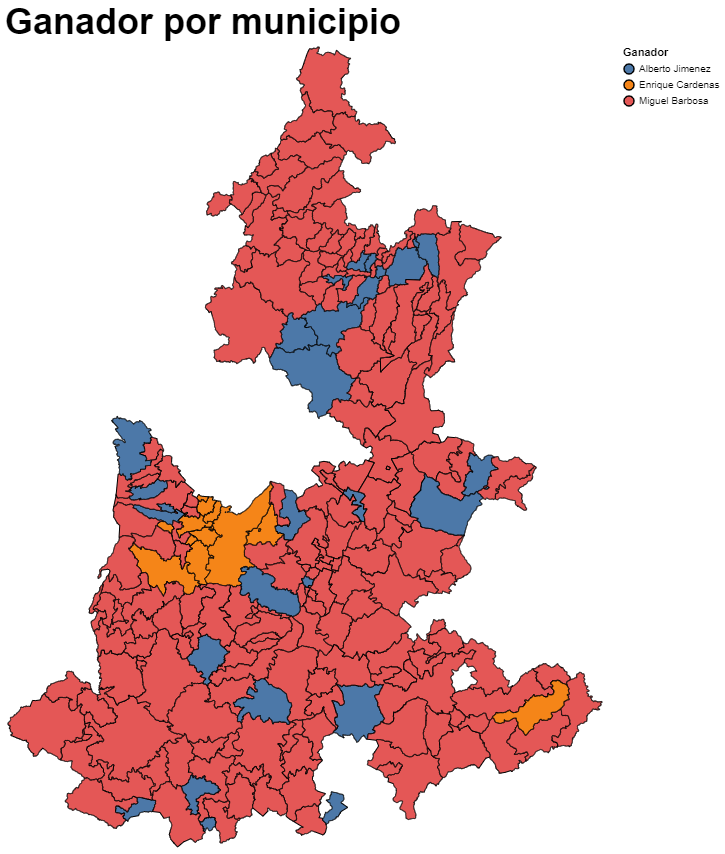

In [20]:
ganador_por_municipio = (base + outcome).properties(title="Ganador por municipio", ).configure_view(
    strokeWidth=0,
).configure_title(fontSize = 36, align = 'left', anchor = 'start')

ganador_por_municipio

## palewire 2

In [21]:
secciones = gpd.read_file(DATOS_EXTERNOS / 'mapas_puebla'/'SECCION.shp')

secciones.head()

,gid,id,entidad,distrito,municipio,seccion,tipo,control,geometry1_,geometry
0,1,102.0,21,1,14,113,3,114.0,None,"POLYGON ((624220.121241881 2218231.45630332, 6..."
1,888,758.0,21,6,115,1319,2,823.0,None,"POLYGON ((588649.611591479 2106827.2561998, 58..."
2,2,177.0,21,1,14,114,2,195.0,None,"POLYGON ((625131.004189697 2218154.0604571, 62..."
3,3,2232.0,21,1,14,115,4,2477.0,None,"POLYGON ((622838.703358738 2221492.84485929, 6..."
4,4,2256.0,21,1,58,502,3,2510.0,None,"POLYGON ((581656.828105251 2237838.39969905, 5..."


In [22]:
secciones_datos = pd.read_csv(DATOS_EXTERNOS / 'elecciones_puebla_por_seccion_2019.csv')

secciones_datos.head()

,SECCION,ALBERTO_JIMENEZ,ENRIQUE_CARDENAS,MIGUEL_BARBOSA,NO_REGISTRADOS,NULOS,TOTAL_VOTOS,LISTA_NOMINAL,aj_porc,ec_porc,mb_porc,no_reg_porc,nulos_porc,parti_porc,abst_porc,GANADOR,PORC_GANADOR,CVE_GANADOR
0,1,161,203,283,0,17,664,2377,24.25,30.57,42.62,0.00,2.56,27.93,72.07,MIGUEL_BARBOSA,42.62,3
1,10,89,211,251,0,8,559,2494,15.92,37.75,44.90,0.00,1.43,22.41,77.59,MIGUEL_BARBOSA,44.90,3
2,100,22,107,328,0,9,466,1340,4.72,22.96,70.39,0.00,1.93,34.78,65.22,MIGUEL_BARBOSA,70.39,3
3,1000,48,641,208,2,13,912,1715,5.26,70.29,22.81,0.22,1.43,53.18,46.82,ENRIQUE_CARDENAS,70.29,2
4,1001,60,259,210,0,15,544,1420,11.03,47.61,38.60,0.00,2.76,38.31,61.69,ENRIQUE_CARDENAS,47.61,2


In [23]:
secciones_con_datos = secciones.merge(secciones_datos, left_on = 'seccion', right_on = 'SECCION')

In [24]:
secciones_con_datos.head(2).T

,0,1
gid,1,888
id,102,758
entidad,21,21
distrito,1,6
municipio,14,115
seccion,113,1319
tipo,3,2
control,114,823
geometry1_,None,None
geometry,"POLYGON ((624220.121241881 2218231.45630332, 6...","POLYGON ((588649.611591479 2106827.2561998, 58..."


In [25]:
secciones_con_datos = secciones_con_datos.rename(columns = {
    "ENRIQUE_CARDENAS": "Enrique Cárdenas Sánchez",
    "ALBERTO_JIMENEZ": "Alberto Jiménez Merino",
    "MIGUEL_BARBOSA": "Miguel Barbosa Huerta",
    "NO_REGISTRADOS": "No registrados",
    "NULOS": "Votos nulos",
    "TOTAL_VOTOS": "Total de votos",
    "GANADOR": "Ganador",
    "PORC_GANADOR": "% del ganador"
})

In [26]:
secciones_con_datos['Ganador'] = secciones_con_datos['Ganador'].str.replace("_", ' ').str.title()

In [27]:
secciones_con_datos = secciones_con_datos[['Alberto Jiménez Merino', 'Enrique Cárdenas Sánchez', 'Miguel Barbosa Huerta', 'No registrados', 'Votos nulos', 'Total de votos', 'LISTA_NOMINAL', 'aj_porc', 'ec_porc', 'mb_porc', 'no_reg_porc', 'nulos_porc', 'parti_porc', 'abst_porc', 'Ganador','% del ganador', 'CVE_GANADOR', 'geometry',]]

In [28]:
secciones_con_datos = secciones_con_datos.to_crs(epsg=4326)

In [29]:
# centroides
secciones_con_datos['centroide_x'] = secciones_con_datos['geometry'].centroid.x
secciones_con_datos['centroide_y'] = secciones_con_datos['geometry'].centroid.y

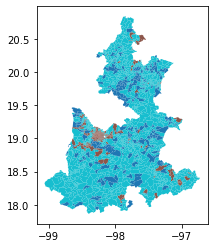

In [30]:
secciones_con_datos.plot(column = 'Ganador');

In [31]:
base_secciones = alt.Chart(secciones_con_datos).mark_geoshape(
    stroke='black',
    strokeWidth=0.1
).encode().properties(
    width=600,
    height=800
)

In [32]:
geoshape_secciones = alt.Chart(secciones_con_datos).mark_geoshape(
    fill='lightgray',
    stroke='black'
)

In [33]:
turnout = alt.Chart(secciones_con_datos).mark_circle().encode(
    longitude='centroide_x:Q',
    latitude='centroide_y:Q',
    size=alt.Size(
        "Total de votos:Q",
        title="Total de votos",
    
    ),
    color = alt.Color('Ganador:N'),
    tooltip = ['Enrique Cárdenas Sánchez', 'Alberto Jiménez Merino', 'Miguel Barbosa Huerta', 'Votos nulos', 'Total de votos', 'Ganador', '% del ganador']
)

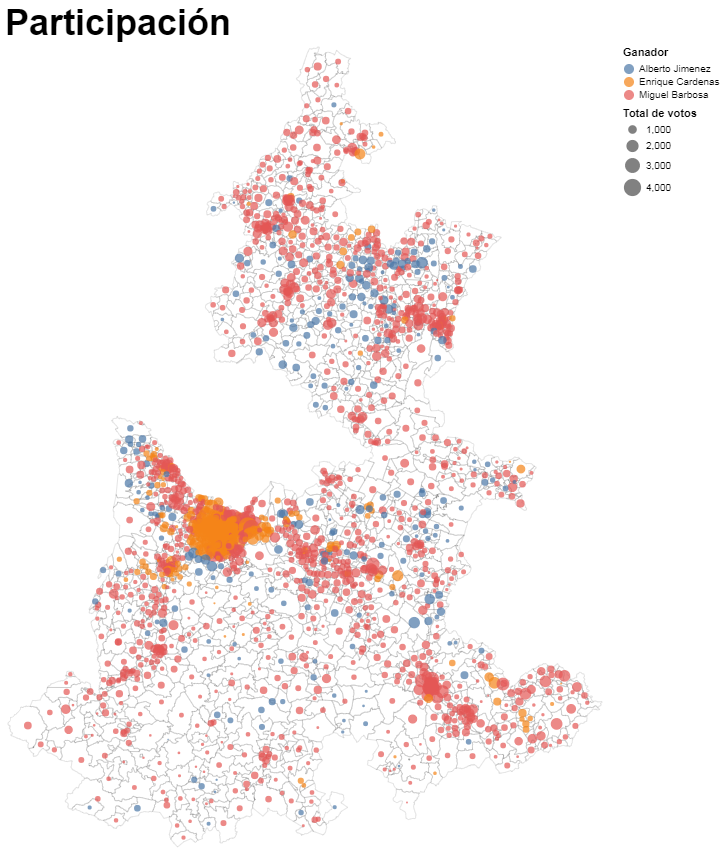

In [34]:
participacion = (base_secciones + turnout).properties(title="Participación").configure_view(
    strokeWidth=0
).configure_title(fontSize = 36, align = 'left', anchor = 'start')

participacion

In [35]:
participacion.save("../reportes/figuras/chart.html")